# Model Testing

In [48]:
import sys
from pathlib import Path
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

from sklearn.model_selection import cross_val_score
from sklearn.ensemble import HistGradientBoostingRegressor, RandomForestRegressor
from sklearn import linear_model
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.discriminant_analysis import StandardScaler
from sklearn.impute import SimpleImputer
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor


project_root = Path(__file__).resolve().parents[2] if "__file__" in globals() else Path().resolve().parents[1]
if str(project_root) not in sys.path:
    sys.path.append(str(project_root))

from src.features.covid_features import add_covid_lockdown_flag, add_covid_stringency_index
from src.features.date_features import add_date_features
from src.features.preprocessing import remove_outliers, handle_missing_values, get_X_y, get_cv
from src.features.lag_features import add_lag_and_rolling_features
from src.features.weather_features import add_weather

from paths import DATA_DIR 
from paths import EXTERNAL_DATA_DIR 

In [34]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
data = pd.read_parquet(DATA_DIR  / "train.parquet")
data_test = pd.read_parquet(DATA_DIR  / "final_test.parquet")

### Simplest Model
Variables: Date (hour, weekdaay, daymonth, IsHoliday), Counter Name

Outliers: Included

In [3]:
mdata = add_date_features(data, use_extended=False)
X, y = get_X_y(mdata)
X.head()

,counter_name,hour,weekday,daymonth,IsHoliday
48321,28 boulevard Diderot E-O,2,1,01_9,False
48324,28 boulevard Diderot E-O,3,1,01_9,False
48327,28 boulevard Diderot E-O,4,1,01_9,False
48330,28 boulevard Diderot E-O,15,1,01_9,False
48333,28 boulevard Diderot E-O,18,1,01_9,False


In [4]:
regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "Lasso": linear_model.Lasso(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }

for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", OneHotEncoder(handle_unknown='ignore', sparse_output=False)),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.95748 +- 0.165
XG Boost - The accuracy is: -0.96059 +- 0.162
Lasso - The accuracy is: -1.67937 +- 0.135


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.95777 +- 0.162


### Simplest Model (different Date Codification)


In [5]:
data = pd.read_parquet(DATA_DIR / "train.parquet")
mdata = add_date_features(data, use_extended=True)
X, y = get_X_y(mdata)
X.head()

,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday
48321,28 boulevard Diderot E-O,2020,9,1,1,2,False,False
48324,28 boulevard Diderot E-O,2020,9,1,1,3,False,False
48327,28 boulevard Diderot E-O,2020,9,1,1,4,False,False
48330,28 boulevard Diderot E-O,2020,9,1,1,15,False,False
48333,28 boulevard Diderot E-O,2020,9,1,1,18,False,False


In [6]:
regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }

for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", OneHotEncoder(handle_unknown='ignore', sparse_output=False)),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.92714 +- 0.177
XG Boost - The accuracy is: -0.91152 +- 0.176


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.92558 +- 0.175


### Without Outliers

In [7]:
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]


,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday
0,28 boulevard Diderot E-O,2020,9,1,1,2,False,False
1,28 boulevard Diderot E-O,2020,9,1,1,3,False,False
2,28 boulevard Diderot E-O,2020,9,1,1,4,False,False
3,28 boulevard Diderot E-O,2020,9,1,1,15,False,False
4,28 boulevard Diderot E-O,2020,9,1,1,18,False,False


In [8]:
regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }

for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", OneHotEncoder(handle_unknown='ignore', sparse_output=False)),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.85843 +- 0.118
XG Boost - The accuracy is: -0.83952 +- 0.122


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.85560 +- 0.121


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


### Sine Cossine Encoding

In [9]:
from sklearn.preprocessing import FunctionTransformer


def sin_transformer(period):
    return FunctionTransformer(lambda x: np.sin(x / period * 2 * np.pi))


def cos_transformer(period):
    return FunctionTransformer(lambda x: np.cos(x / period * 2 * np.pi))

In [10]:
data = pd.read_parquet(DATA_DIR / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]


,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday
0,28 boulevard Diderot E-O,2020,9,1,1,2,False,False
1,28 boulevard Diderot E-O,2020,9,1,1,3,False,False
2,28 boulevard Diderot E-O,2020,9,1,1,4,False,False
3,28 boulevard Diderot E-O,2020,9,1,1,15,False,False
4,28 boulevard Diderot E-O,2020,9,1,1,18,False,False


In [11]:
categorical_columns = ["counter_name", "year", "day", "is_weekend", "IsHoliday", "month", "day_of_week"]

preprocessor = ColumnTransformer(
    transformers=[
        ("categorical", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
        ("hour_sin", sin_transformer(24), ["hour"]),
        ("hour_cos", cos_transformer(24), ["hour"]),
    ],
#    remainder=MinMaxScaler(),
)

regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }

for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", preprocessor),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.83739 +- 0.122
XG Boost - The accuracy is: -0.82384 +- 0.130


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.83852 +- 0.122


### Sine And Cosine Features without day

In [12]:
data = pd.read_parquet(DATA_DIR / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata).drop(columns="day")
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]


,counter_name,year,month,day_of_week,hour,is_weekend,IsHoliday
0,28 boulevard Diderot E-O,2020,9,1,2,False,False
1,28 boulevard Diderot E-O,2020,9,1,3,False,False
2,28 boulevard Diderot E-O,2020,9,1,4,False,False
3,28 boulevard Diderot E-O,2020,9,1,15,False,False
4,28 boulevard Diderot E-O,2020,9,1,18,False,False


In [13]:
categorical_columns = ["counter_name", "year", "is_weekend", "IsHoliday", "month", "day_of_week"]

preprocessor = ColumnTransformer(
    transformers=[
        ("categorical", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
        ("hour_sin", sin_transformer(24), ["hour"]),
        ("hour_cos", cos_transformer(24), ["hour"]),
    ],
#    remainder=MinMaxScaler(),
)

regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }

for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", preprocessor),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.85620 +- 0.121
XG Boost - The accuracy is: -0.85017 +- 0.122


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.85558 +- 0.123


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


### Periodic Spline Features

In [14]:
from sklearn.preprocessing import SplineTransformer


def periodic_spline_transformer(period, n_splines=None, degree=3):
    if n_splines is None:
        n_splines = period
    n_knots = n_splines + 1  # periodic and include_bias is True
    return SplineTransformer(
        degree=degree,
        n_knots=n_knots,
        knots=np.linspace(0, period, n_knots).reshape(n_knots, 1),
        extrapolation="periodic",
        include_bias=True,
    )

In [15]:
data = pd.read_parquet(DATA_DIR / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]


,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday
0,28 boulevard Diderot E-O,2020,9,1,1,2,False,False
1,28 boulevard Diderot E-O,2020,9,1,1,3,False,False
2,28 boulevard Diderot E-O,2020,9,1,1,4,False,False
3,28 boulevard Diderot E-O,2020,9,1,1,15,False,False
4,28 boulevard Diderot E-O,2020,9,1,1,18,False,False


In [16]:
categorical_columns = ["counter_name", "year", "day", "is_weekend", "IsHoliday", "month", "day_of_week"]

preprocessor = ColumnTransformer(
    transformers=[
        ("categorical", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
        ("cyclic_hour", periodic_spline_transformer(24, n_splines=12), ["hour"]),
    ],
#    remainder=MinMaxScaler(),
)

regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }

for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", preprocessor),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.84448 +- 0.122
XG Boost - The accuracy is: -0.82768 +- 0.124


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.84149 +- 0.121


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


### Without Outliers, With 1/0 Covid-19 Column

In [17]:
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
mdata = add_covid_lockdown_flag(mdata)
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]


,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday,covid_lockdown
0,28 boulevard Diderot E-O,2020,9,1,1,2,False,False,0
1,28 boulevard Diderot E-O,2020,9,1,1,3,False,False,0
2,28 boulevard Diderot E-O,2020,9,1,1,4,False,False,0
3,28 boulevard Diderot E-O,2020,9,1,1,15,False,False,0
4,28 boulevard Diderot E-O,2020,9,1,1,18,False,False,0


In [18]:
regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }

for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", OneHotEncoder(handle_unknown='ignore', sparse_output=False)),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.85373 +- 0.121
XG Boost - The accuracy is: -0.83691 +- 0.124


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.85730 +- 0.122


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


### Without Outliers, With Index for Covid-19

In [21]:
data = pd.read_parquet(DATA_DIR / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
mdata = add_covid_stringency_index(mdata, EXTERNAL_DATA_DIR / 'Covid_19_Index.csv')
mdata.isnull().sum()
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]
/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/covid_features.py:64: DtypeWarning: Columns (2,3,44,45) have mixed types. Specify dtype option on import or set low_memory=False.
  covid_index = pd.read_csv(path)


,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday,StringencyIndex_Average
0,28 boulevard Diderot E-O,2020,9,1,1,2,False,False,46.76
1,28 boulevard Diderot E-O,2020,9,1,1,3,False,False,46.76
2,28 boulevard Diderot E-O,2020,9,1,1,4,False,False,46.76
3,28 boulevard Diderot E-O,2020,9,1,1,15,False,False,46.76
4,28 boulevard Diderot E-O,2020,9,1,1,18,False,False,46.76


In [22]:

numerical_columns = ["StringencyIndex_Average"]
categorical_columns = ["counter_name", "year", "month", "day", "day_of_week", "is_weekend", "IsHoliday"]

preprocessor = ColumnTransformer(transformers=[
    ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
    ("hour_sin", sin_transformer(24), ["hour"]),
    ("hour_cos", cos_transformer(24), ["hour"])
], remainder='passthrough')

regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }
for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", preprocessor),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), 
                             n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.82812 +- 0.122
XG Boost - The accuracy is: -0.82335 +- 0.127


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.82771 +- 0.126


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


### With Weather Data

Outliers: Removed

Missing Values: Linear Interpolation

In [24]:
data = pd.read_parquet(DATA_DIR  / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
mdata = add_weather(mdata, EXTERNAL_DATA_DIR / 'weather_data.csv')
mdata = handle_missing_values(mdata, "linear")
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]


,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday,t,rr1,u,ht_neige,raf10,ff,ww,etat_sol,tend
0,Face au 8 avenue de la porte de Charenton NO-SE,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
1,Voie Georges Pompidou NE-SO,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
2,20 Avenue de Clichy NO-SE,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
3,Pont des Invalides S-N,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
4,39 quai François Mauriac NO-SE,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10


In [25]:
numerical_columns = ['t', 'rr1', 'u', 'ht_neige', 'raf10', 'ff', 'ww', 'etat_sol', 'tend']
categorical_columns = ["counter_name", "year", "month", "day", "day_of_week", "hour", "is_weekend", "IsHoliday"]

preprocessor = ColumnTransformer(transformers=[
    ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns)
], remainder='passthrough')

regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }
for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", preprocessor),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), 
                             n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.70004 +- 0.123
XG Boost - The accuracy is: -0.70420 +- 0.143


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.69606 +- 0.123


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Outliers: Removed

Missing Values: Median

In [27]:
data = pd.read_parquet(DATA_DIR  / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
mdata = add_weather(mdata, EXTERNAL_DATA_DIR / 'weather_data.csv')
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]


,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday,t,rr1,u,ht_neige,raf10,ff,ww,etat_sol,tend
original_index,,,,,,,,,,,,,,,,,
0,28 boulevard Diderot E-O,2020,9,1,1,2,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
1,28 boulevard Diderot E-O,2020,9,1,1,3,False,False,283.95,0.0,88,0.0,1.5,1.1,2,0.0,-60
2,28 boulevard Diderot E-O,2020,9,1,1,4,False,False,283.95,0.0,88,0.0,1.5,1.1,2,0.0,-60
3,28 boulevard Diderot E-O,2020,9,1,1,15,False,False,293.65,0.0,41,0.0,7.5,4.0,3,0.0,-110
4,28 boulevard Diderot E-O,2020,9,1,1,18,False,False,292.15,0.0,47,0.0,6.5,3.0,2,0.0,10


In [28]:
numerical_columns = ['t', 'rr1', 'u', 'ht_neige', 'raf10', 'ff', 'ww', 'etat_sol', 'tend']
categorical_columns = ["counter_name", "year", "month", "day", "day_of_week", "hour", "is_weekend", "IsHoliday"]

preprocessor = ColumnTransformer(transformers=[
    ("num", SimpleImputer(strategy='median'), numerical_columns),
    ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns)
], remainder='passthrough')

regressors = {"Histogram-based Gradient Boosting": HistGradientBoostingRegressor(),
             "XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }
for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", preprocessor),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), 
                             n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

Histogram-based Gradient Boosting - The accuracy is: -0.84883 +- 0.117
XG Boost - The accuracy is: -0.83677 +- 0.123


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.84512 +- 0.115


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


### Weather Data with Sin and Cos

In [29]:
data = pd.read_parquet(DATA_DIR  / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
mdata = add_weather(mdata, EXTERNAL_DATA_DIR / 'weather_data.csv')
mdata = handle_missing_values(mdata, "linear")
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]


,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday,t,rr1,u,ht_neige,raf10,ff,ww,etat_sol,tend
0,Face au 8 avenue de la porte de Charenton NO-SE,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
1,Voie Georges Pompidou NE-SO,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
2,20 Avenue de Clichy NO-SE,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
3,Pont des Invalides S-N,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
4,39 quai François Mauriac NO-SE,2020,9,1,1,1,False,False,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10


In [30]:
numerical_columns = ['t', 'rr1', 'u', 'ht_neige', 'raf10', 'ff', 'ww', 'etat_sol', 'tend']
categorical_columns = ["counter_name", "year", "month", "day", "day_of_week", "is_weekend", "IsHoliday"]

preprocessor = ColumnTransformer(transformers=[
    ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
    ("hour_sin", sin_transformer(24), ["hour"]),
    ("hour_cos", cos_transformer(24), ["hour"]),
], remainder='passthrough')

regressors = {"XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }
for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", preprocessor),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), 
                             n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

XG Boost - The accuracy is: -0.66857 +- 0.134


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.68253 +- 0.124


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


### Weather Features - one by one

In [31]:
data = pd.read_parquet(DATA_DIR  / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
mdata = add_covid_stringency_index(mdata, EXTERNAL_DATA_DIR / 'Covid_19_Index.csv')
mdata = add_weather(mdata, EXTERNAL_DATA_DIR / 'weather_data.csv')
mdata = handle_missing_values(mdata, "linear")
X, y = get_X_y(mdata)
X.head()

/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/preprocessing.py:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["counter_name", "date_truncated"])["log_bike_count"]
/Users/joaosilva/Current/Career/Projects/bike_counters/src/features/covid_features.py:64: DtypeWarning: Columns (2,3,44,45) have mixed types. Specify dtype option on import or set low_memory=False.
  covid_index = pd.read_csv(path)


,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday,StringencyIndex_Average,t,rr1,u,ht_neige,raf10,ff,ww,etat_sol,tend
0,Face au 8 avenue de la porte de Charenton NO-SE,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
1,Voie Georges Pompidou NE-SO,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
2,20 Avenue de Clichy NO-SE,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
3,Pont des Invalides S-N,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
4,39 quai François Mauriac NO-SE,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10


In [41]:
numerical_columns = ['t', 'rr1', 'u', 'ht_neige', 'raf10', 'ff', 'ww', 'etat_sol', 'tend']
categorical_columns = ["counter_name", "year", "month", "day", "day_of_week", "is_weekend", "IsHoliday"]

def test_numerical_variables_with_baseline(numerical_columns, categorical_columns, X, y, regressors):
    results = []
    
    # Baseline test: No numerical variables
    print("Testing baseline: No numerical features")
    baseline_preprocessor = ColumnTransformer(transformers=[
        ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
        ("hour_sin", sin_transformer(24), ["hour"]),
        ("hour_cos", cos_transformer(24), ["hour"]),
        ("num", "passthrough", ["StringencyIndex_Average"])
    ], remainder='drop')  # Only categorical and time features

    for regressor_name, regressor in regressors.items():
        pipeline = Pipeline([
            ("preprocessor", baseline_preprocessor),
            ("regressor", regressor)
        ])

        scores = cross_val_score(
            pipeline, X, y, cv=get_cv(X, y),
            n_jobs=-1, scoring="neg_root_mean_squared_error"
        )

        results.append({
            "Feature": "None (Baseline)",
            "Regressor": regressor_name,
            "Mean RMSE": -scores.mean(),
            "Std RMSE": scores.std()
        })

        print(f"  {regressor_name}: Mean RMSE: {-scores.mean():.5f}, Std: {scores.std():.3f}")

    # Test each numerical variable
    for num_col in numerical_columns:
        print(f"Testing with numerical feature: {num_col}")
        
        # Use only the selected numerical column and the mandatory categorical columns
        test_preprocessor = ColumnTransformer(transformers=[
            ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
            ("hour_sin", sin_transformer(24), ["hour"]),
            ("hour_cos", cos_transformer(24), ["hour"]),
            ("num", "passthrough", ["StringencyIndex_Average", num_col])  # Use passthrough for the current numerical column
        ], remainder='drop')  # Drop other features
        
        for regressor_name, regressor in regressors.items():
            # Build pipeline
            pipeline = Pipeline([
                ("preprocessor", test_preprocessor),
                ("regressor", regressor)
            ])
            
            # Perform cross-validation
            scores = cross_val_score(
                pipeline, X, y, cv=get_cv(X, y),
                n_jobs=-1, scoring="neg_root_mean_squared_error"
            )
            
            # Store results
            results.append({
                "Feature": num_col,
                "Regressor": regressor_name,
                "Mean RMSE": -scores.mean(),
                "Std RMSE": scores.std()
            })
            
            print(f"  {regressor_name}: Mean RMSE: {-scores.mean():.5f}, Std: {scores.std():.3f}")
    
    # Convert results to DataFrame for easy viewing
    results_df = pd.DataFrame(results)
    return results_df

# Run the function
results_df = test_numerical_variables_with_baseline(numerical_columns, categorical_columns, X, y, regressors)

# Display the results
display(results_df.sort_values(by="Mean RMSE"))

Testing baseline: No numerical features


  XG Boost: Mean RMSE: 0.67168, Std: 0.127


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.67637, Std: 0.115
Testing with numerical feature: t
  XG Boost: Mean RMSE: 0.66892, Std: 0.138


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.66669, Std: 0.119
Testing with numerical feature: rr1
  XG Boost: Mean RMSE: 0.67587, Std: 0.131


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.66981, Std: 0.121
Testing with numerical feature: u
  XG Boost: Mean RMSE: 0.66753, Std: 0.133


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.66715, Std: 0.121
Testing with numerical feature: ht_neige
  XG Boost: Mean RMSE: 0.66832, Std: 0.130


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.67049, Std: 0.120
Testing with numerical feature: raf10
  XG Boost: Mean RMSE: 0.67934, Std: 0.128


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.67434, Std: 0.115
Testing with numerical feature: ff
  XG Boost: Mean RMSE: 0.67528, Std: 0.130


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.67800, Std: 0.114
Testing with numerical feature: ww
  XG Boost: Mean RMSE: 0.67036, Std: 0.133


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.67475, Std: 0.120
Testing with numerical feature: etat_sol
  XG Boost: Mean RMSE: 0.66372, Std: 0.140


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.66861, Std: 0.132
Testing with numerical feature: tend
  XG Boost: Mean RMSE: 0.67744, Std: 0.128


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

  LightGBM: Mean RMSE: 0.67452, Std: 0.119


,Feature,Regressor,Mean RMSE,Std RMSE
16,etat_sol,XG Boost,0.663717,0.140147
3,t,LightGBM,0.666693,0.118626
7,u,LightGBM,0.667148,0.120882
6,u,XG Boost,0.667526,0.133071
8,ht_neige,XG Boost,0.668317,0.130101
17,etat_sol,LightGBM,0.668610,0.131573
2,t,XG Boost,0.668918,0.137649
5,rr1,LightGBM,0.669813,0.121004
14,ww,XG Boost,0.670355,0.133394
9,ht_neige,LightGBM,0.670490,0.119614


In [42]:
data = pd.read_parquet(DATA_DIR  / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
mdata = add_covid_stringency_index(mdata, EXTERNAL_DATA_DIR / 'Covid_19_Index.csv')
mdata = add_weather(mdata, EXTERNAL_DATA_DIR / 'weather_data.csv')
mdata = handle_missing_values(mdata, "linear")
X, y = get_X_y(mdata)
X.head()

,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday,StringencyIndex_Average,t,rr1,u,ht_neige,raf10,ff,ww,etat_sol,tend
0,Face au 8 avenue de la porte de Charenton NO-SE,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
1,Voie Georges Pompidou NE-SO,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
2,20 Avenue de Clichy NO-SE,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
3,Pont des Invalides S-N,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
4,39 quai François Mauriac NO-SE,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10


In [43]:
numerical_columns = ['t', 'rr1', 'u', 'ht_neige', 'raf10', 'ff', 'ww', 'etat_sol', 'tend']
categorical_columns = ["counter_name", "year", "month", "day", "day_of_week", "is_weekend", "IsHoliday"]

preprocessor = ColumnTransformer(transformers=[
    ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
    ("hour_sin", sin_transformer(24), ["hour"]),
    ("hour_cos", cos_transformer(24), ["hour"]),
    ("num", "passthrough", ["StringencyIndex_Average", "etat_sol", "t", "u", "ht_neige", "ww"])
], remainder='drop')

regressors = {"XG Boost": XGBRegressor()}

for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", preprocessor),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), 
                             n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(scores)
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

[-0.88137563 -0.80402402 -0.6232736  -0.48958994 -0.81122456 -0.56512486
 -0.57516046 -0.52189352]
XG Boost - The accuracy is: -0.65896 +- 0.141


### Weather Data, Sin Cos, Covid Index

In [44]:
data = pd.read_parquet(DATA_DIR  / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
mdata = add_covid_stringency_index(mdata, EXTERNAL_DATA_DIR / 'Covid_19_Index.csv')
mdata = add_weather(mdata, EXTERNAL_DATA_DIR / 'weather_data.csv')
mdata = handle_missing_values(mdata, "linear")
X, y = get_X_y(mdata)
X.head()

,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday,StringencyIndex_Average,t,rr1,u,ht_neige,raf10,ff,ww,etat_sol,tend
0,Face au 8 avenue de la porte de Charenton NO-SE,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
1,Voie Georges Pompidou NE-SO,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
2,20 Avenue de Clichy NO-SE,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
3,Pont des Invalides S-N,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10
4,39 quai François Mauriac NO-SE,2020,9,1,1,1,False,False,46.76,285.75,0.0,81,0.0,2.4,1.6,1,0.0,-10


In [45]:
numerical_columns = ['t', 'rr1', 'u', 'ht_neige', 'raf10', 'ff', 'ww', 'etat_sol', 'tend']
categorical_columns = ["counter_name", "year", "month", "day", "day_of_week", "is_weekend", "IsHoliday"]

preprocessor = ColumnTransformer(transformers=[
    ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
    ("hour_sin", sin_transformer(24), ["hour"]),
    ("hour_cos", cos_transformer(24), ["hour"]),
], remainder='passthrough')

regressors = {"XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
            }
for regressor_name, regressor in regressors.items():
    pipeline = Pipeline([
        ("preprocessor", preprocessor),
        ("regressor", regressor)
    ])

    scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), 
                             n_jobs=-1, scoring="neg_root_mean_squared_error")
    print(f"{regressor_name} - The accuracy is: {scores.mean():.5f} +- {scores.std():.3f}")

XG Boost - The accuracy is: -0.65841 +- 0.144


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - The accuracy is: -0.66109 +- 0.130


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [46]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
import numpy as np

preprocessor = ColumnTransformer(transformers=[
    ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
    ("hour_sin", sin_transformer(24), ["hour"]),
    ("hour_cos", cos_transformer(24), ["hour"]),
], remainder='passthrough')

# Train the models and extract feature importance
for regressor_name, regressor in regressors.items():
    
    X_transformed = preprocessor.fit_transform(X)
    
    feature_names = []
    for name, transformer, columns in preprocessor.transformers_:
        if name == "cat":  # For OneHotEncoder
            feature_names.extend(transformer.get_feature_names_out(columns))
        else:
            feature_names.extend(columns)  # Numerical and other features
    
    # Fit the regressor
    regressor.fit(X_transformed, y)
    
    # Get feature importances
    importances = regressor.feature_importances_

    # Combine feature names and importances
    importance_df = pd.DataFrame({
        "Feature": feature_names,
        "Importance": importances
    }).sort_values(by="Importance", ascending=False)
    
    print(f"\n{regressor_name} Feature Importances:")
    display(importance_df.head(40))



XG Boost Feature Importances:


,Feature,Importance
10,counter_name_28 boulevard Diderot E-O,0.064433
30,counter_name_Face au 40 quai D'Issy SO-NE,0.057542
113,hour,0.053338
49,counter_name_Totem 73 boulevard de Sébastopol S-N,0.051862
48,counter_name_Totem 73 boulevard de Sébastopol N-S,0.051148
47,counter_name_Totem 64 Rue de Rivoli O-E,0.041675
29,counter_name_Face au 40 quai D'Issy NE-SO,0.041064
35,counter_name_Face au 8 avenue de la porte de C...,0.035742
20,counter_name_67 boulevard Voltaire SE-NO,0.033189
28,counter_name_Face au 4 avenue de la porte de B...,0.030860



LightGBM Feature Importances:


,Feature,Importance
112,hour,318
113,hour,274
114,8,217
108,is_weekend_False,115
115,9,96
10,counter_name_28 boulevard Diderot E-O,66
49,counter_name_Totem 73 boulevard de Sébastopol S-N,60
30,counter_name_Face au 40 quai D'Issy SO-NE,60
29,counter_name_Face au 40 quai D'Issy NE-SO,54
61,month_4,54


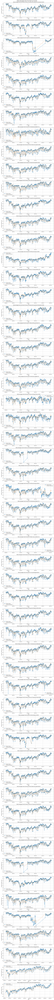

In [49]:
# Get unique counters
# Initialize the predictions DataFrame
predictions_df = mdata[["datetime", "day_of_week", "month", "log_bike_count", "counter_name"]].copy()

regressors = {"XG Boost": XGBRegressor(),
            }

# Preprocess features
X_transformed = preprocessor.fit_transform(X)

# Add predictions for each regressor
for regressor_name, regressor in regressors.items():
    regressor.fit(X_transformed, y)
    predictions = regressor.predict(X_transformed)
    predictions_df[regressor_name] = predictions


# Convert datetime to date for grouping by day
predictions_df["date"] = predictions_df["datetime"].dt.date

# Initialize a plot for daily averages over the year
unique_counters = predictions_df["counter_name"].unique()
num_counters = len(unique_counters)

# Create subplots for each counter
fig, axes = plt.subplots(nrows=num_counters, ncols=1, figsize=(12, 4 * num_counters), constrained_layout=True)

for i, counter in enumerate(unique_counters):
    ax = axes[i] if num_counters > 1 else axes  # Handle single subplot case
    counter_data = predictions_df[predictions_df["counter_name"] == counter]

    # Group by date to calculate daily averages
    daily_avg = (
        counter_data
        .groupby("date")
        .mean(numeric_only=True)  # Average for each day
    )

    # Plot daily averages
    ax.plot(daily_avg.index, daily_avg["log_bike_count"], label="Original Values", marker='o', linestyle='-', alpha=0.8)
    for regressor_name in regressors.keys():
        ax.plot(daily_avg.index, daily_avg[regressor_name], label=f"{regressor_name} Predictions", linestyle='--', alpha=0.8)
    
    ax.set_title(f"Daily Averages Over the Year for {counter}")
    ax.set_xlabel("Date")
    ax.set_ylabel("Average Log Bike Count")
    ax.legend()
    ax.grid()

plt.suptitle("Daily Averages Over the Year by Counter", fontsize=16)
plt.show()


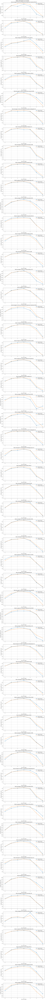

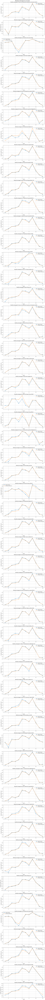

In [50]:
# Get unique counters
# Initialize the predictions DataFrame
predictions_df = mdata[["datetime", "day_of_week", "month", "log_bike_count", "counter_name"]].copy()


# Preprocess features
X_transformed = preprocessor.fit_transform(X)

# Add predictions for each regressor
for regressor_name, regressor in regressors.items():
    regressor.fit(X_transformed, y)
    predictions = regressor.predict(X_transformed)
    predictions_df[regressor_name] = predictions

unique_counters = predictions_df["counter_name"].unique()

# Number of counters
num_counters = len(unique_counters)

# Plot daily averages for all counters in subplots
fig, axes = plt.subplots(nrows=num_counters, ncols=1, figsize=(10, 4 * num_counters), constrained_layout=True)

for i, counter in enumerate(unique_counters):
    ax = axes[i] if num_counters > 1 else axes  # Handle single subplot case
    counter_data = predictions_df[predictions_df["counter_name"] == counter]

    # Daily averages for the specific counter
    daily_avg = (
        counter_data
        .groupby("day_of_week")
        .mean(numeric_only=True)
    )
    
    # Plot daily averages
    ax.plot(daily_avg.index, daily_avg["log_bike_count"], label="Original Values", marker='o')
    for regressor_name in regressors.keys():
        ax.plot(daily_avg.index, daily_avg[regressor_name], label=f"{regressor_name} Predictions", marker='x')
    
    ax.set_title(f"Daily Averages for {counter}")
    ax.set_xlabel("Day of the Week")
    ax.set_ylabel("Average Log Bike Count")
    ax.legend()
    ax.grid()

plt.suptitle("Daily Averages by Counter", fontsize=16)
plt.show()

# Plot monthly averages for all counters in subplots
fig, axes = plt.subplots(nrows=num_counters, ncols=1, figsize=(10, 4 * num_counters), constrained_layout=True)

for i, counter in enumerate(unique_counters):
    ax = axes[i] if num_counters > 1 else axes  # Handle single subplot case
    counter_data = predictions_df[predictions_df["counter_name"] == counter]

    # Monthly averages for the specific counter
    monthly_avg = (
        counter_data[["month", "log_bike_count"] + list(regressors.keys())]
        .groupby("month")
        .mean(numeric_only=True)
    )

    # Plot monthly averages
    ax.plot(monthly_avg.index, monthly_avg["log_bike_count"], label="Original Values", marker='o')
    for regressor_name in regressors.keys():
        ax.plot(monthly_avg.index, monthly_avg[regressor_name], label=f"{regressor_name} Predictions", marker='x')
    
    ax.set_title(f"Monthly Averages for {counter}")
    ax.set_xlabel("Month")
    ax.set_ylabel("Average Log Bike Count")
    ax.legend()
    ax.grid()

plt.suptitle("Monthly Averages by Counter", fontsize=16)
plt.show()


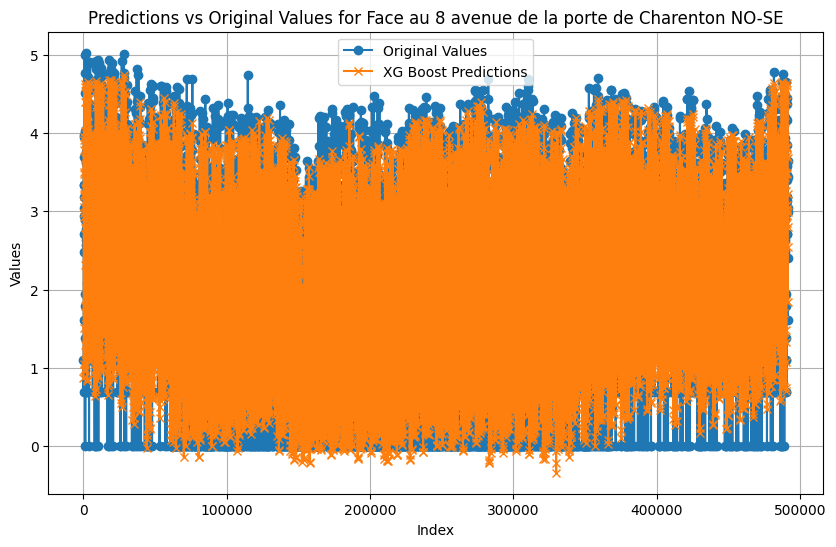

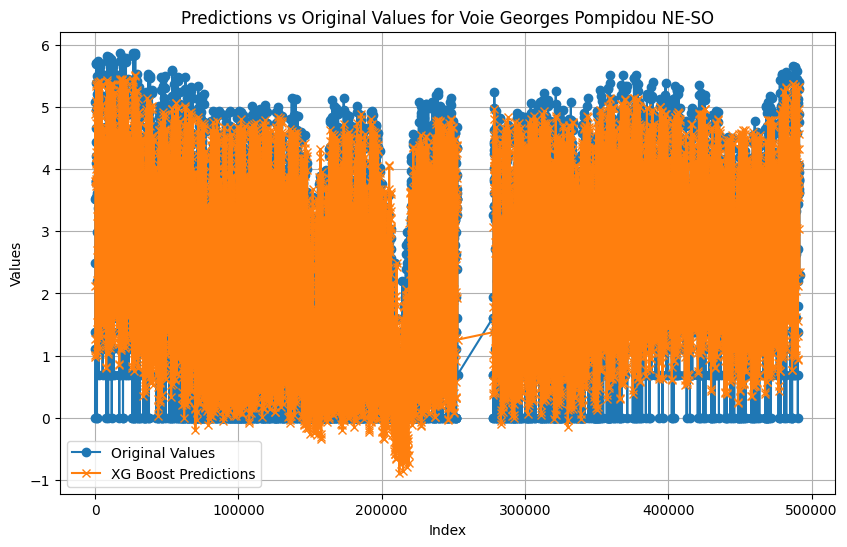

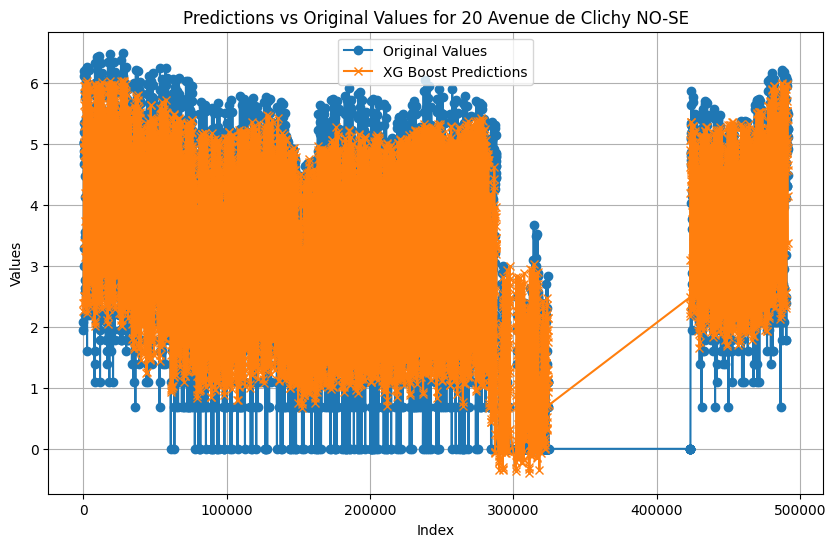

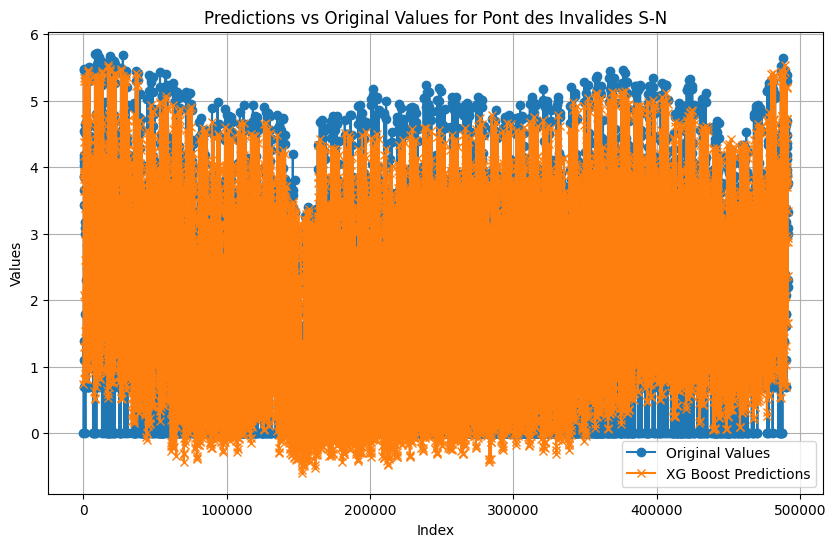

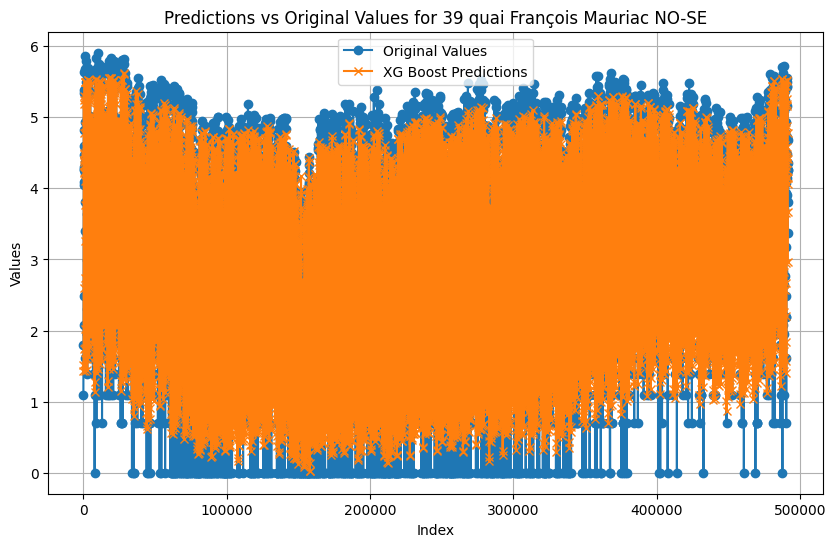

...

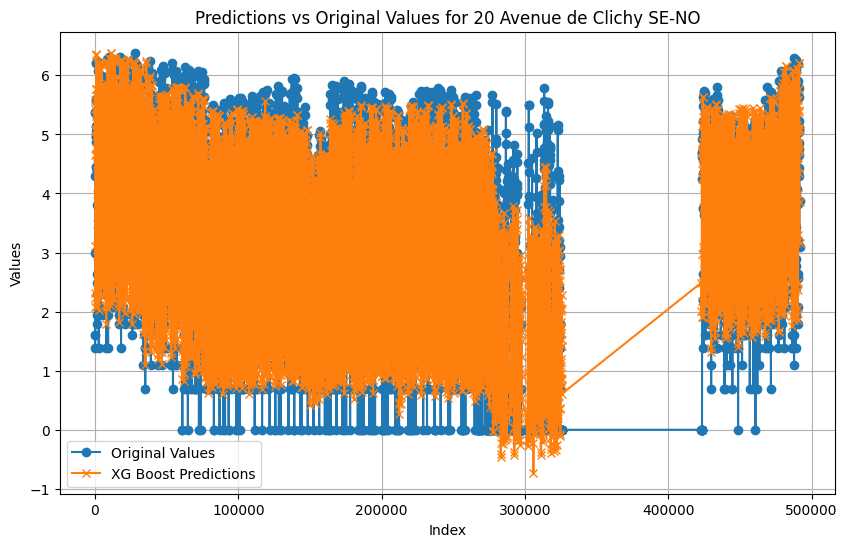

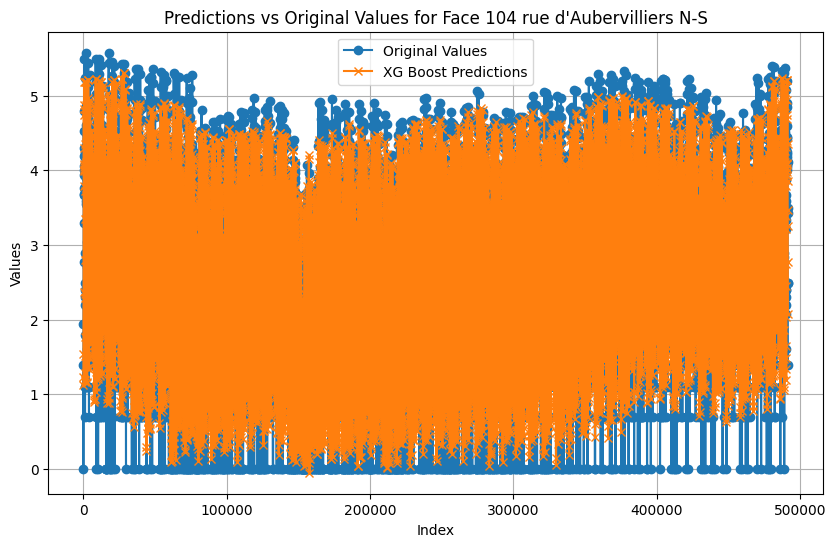

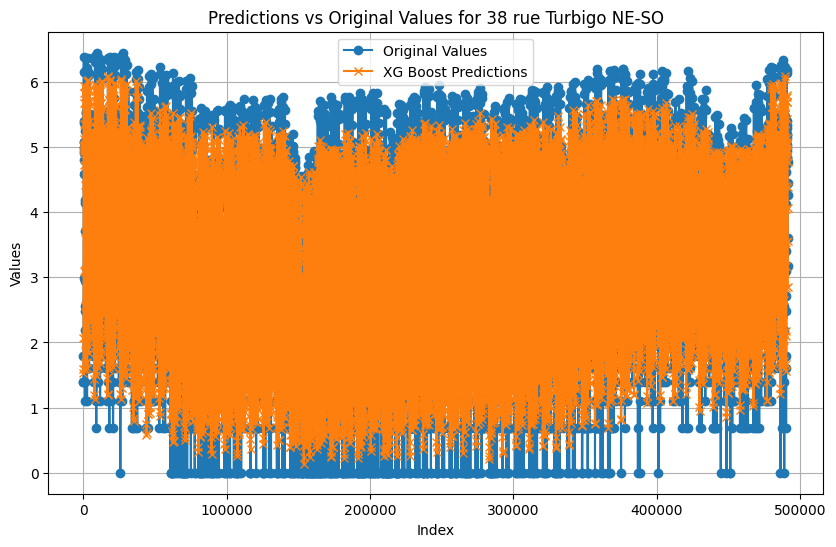

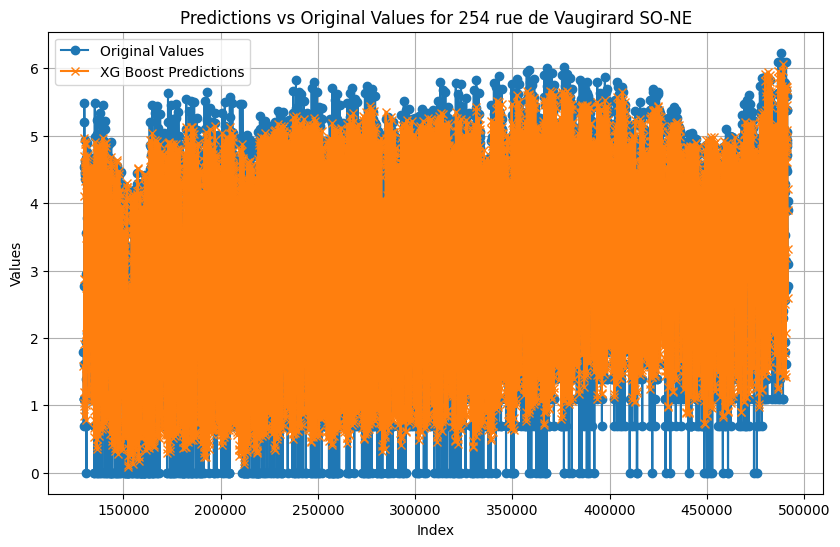

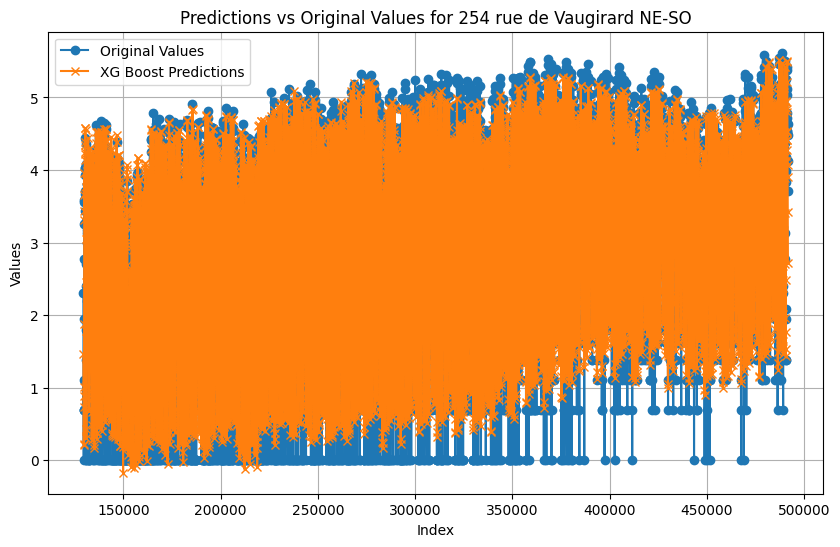

In [51]:
import pandas as pd
import matplotlib.pyplot as plt


# Preprocess features
X_transformed = preprocessor.fit_transform(X)

# Add predictions for each regressor to a DataFrame
predictions_df = mdata[["counter_name"]].copy()  # Start with counter_name column
predictions_df["original_values"] = y  # Add original values

for regressor_name, regressor in regressors.items():
    # Train the regressor
    regressor.fit(X_transformed, y)
    
    # Predict on the transformed features
    predictions = regressor.predict(X_transformed)
    
    # Add predictions to the DataFrame
    predictions_df[regressor_name] = predictions

# Plot predictions vs original values for each counter_name
unique_counters = predictions_df["counter_name"].unique()

for counter in unique_counters:
    # Filter data for the current counter_name
    counter_data = predictions_df[predictions_df["counter_name"] == counter]
    
    plt.figure(figsize=(10, 6))
    
    # Plot original values
    plt.plot(counter_data.index, counter_data["original_values"], label="Original Values", marker='o')
    
    # Plot predictions for each regressor
    for regressor_name in regressors.keys():
        plt.plot(counter_data.index, counter_data[regressor_name], label=f"{regressor_name} Predictions", marker='x')
    
    plt.title(f"Predictions vs Original Values for {counter}")
    plt.xlabel("Index")
    plt.ylabel("Values")
    plt.legend()
    plt.grid()
    plt.show()


### With Lags

Check all features, one by one

In [52]:
data = pd.read_parquet(DATA_DIR  / "train.parquet")
mdata = add_date_features(data, use_extended=True)
mdata = remove_outliers(mdata)
mdata = add_weather(mdata, EXTERNAL_DATA_DIR / 'weather_data.csv')
mdata = add_lag_and_rolling_features(mdata)
X, y = get_X_y(mdata)
X.head()

,counter_name,year,month,day,day_of_week,hour,is_weekend,IsHoliday,t,rr1,...,ww,etat_sol,tend,lag_1,lag_24,lag_168,rolling_mean_24h,rolling_std_24h,rolling_mean_7d,rolling_std_7d
169,28 boulevard Diderot O-E,2020,9,8,1,2,False,False,288.25,0.0,...,1,0.0,50,1.0,2.0,2.0,74.416667,70.794201,65.089286,58.821747
170,28 boulevard Diderot O-E,2020,9,8,1,3,False,False,287.25,0.0,...,3,0.0,-20,4.0,2.0,7.0,74.625000,70.578857,65.089286,58.821747
171,28 boulevard Diderot O-E,2020,9,8,1,4,False,False,287.25,0.0,...,3,0.0,-20,7.0,4.0,10.0,74.875000,70.327997,65.089286,58.821747
172,28 boulevard Diderot O-E,2020,9,8,1,5,False,False,287.25,0.0,...,3,0.0,-20,10.0,48.0,48.0,75.416667,70.161873,65.166667,58.807681
173,28 boulevard Diderot O-E,2020,9,8,1,6,False,False,288.05,0.0,...,3,0.0,50,61.0,133.0,95.0,76.125000,70.850923,65.494048,59.126982


In [53]:
weather_columns = ['t', 'rr1', 'u', 'ht_neige', 'raf10', 'ff', 'ww', 'etat_sol', 'tend']
categorical_columns = ["counter_name", "year", "month", "day", "day_of_week", 
                       "hour", "is_weekend", "IsHoliday"]
lag_columns = ["lag_1", "lag_24", "lag_168", "rolling_mean_24h", "rolling_std_24h", 
               "rolling_mean_7d", "rolling_std_7d"]

preprocessor = ColumnTransformer([
    ("num", SimpleImputer(strategy='median'), weather_columns),
    ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns)
])

regressors = {"XG Boost": XGBRegressor(),
             "LightGBM": LGBMRegressor(verbosity=-1),
}

for i in range(0, len(lag_columns)):
    current_lag_columns = [lag_columns[i]]  # Add one lag column at a time
    print(f"\nEvaluating with lag columns: {current_lag_columns}")
    
    # Update the preprocessor to include the current lag columns
    preprocessor = ColumnTransformer([
        ("num", SimpleImputer(strategy='median'), weather_columns + current_lag_columns),
        ("cat", OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_columns),
    ])
    
    for regressor_name, regressor in regressors.items():
        # Define the pipeline
        pipeline = Pipeline([
            ("preprocessor", preprocessor),
            ("regressor", regressor)
        ])
        
        # Perform cross-validation
        scores = cross_val_score(pipeline, X, y, cv=get_cv(X, y), 
                                 n_jobs=-1, scoring="neg_root_mean_squared_error")
        
        # Print results
        print(f"{regressor_name} - RMSE: {abs(scores.mean()):.5f} ± {scores.std():.3f}")


Evaluating with lag columns: ['lag_1']


XG Boost - RMSE: 0.46679 ± 0.039


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - RMSE: 0.46959 ± 0.035

Evaluating with lag columns: ['lag_24']
XG Boost - RMSE: 0.50740 ± 0.043


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - RMSE: 0.50804 ± 0.037

Evaluating with lag columns: ['lag_168']
XG Boost - RMSE: 0.50764 ± 0.055


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - RMSE: 0.50941 ± 0.049

Evaluating with lag columns: ['rolling_mean_24h']
XG Boost - RMSE: 0.52323 ± 0.038


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - RMSE: 0.55391 ± 0.032

Evaluating with lag columns: ['rolling_std_24h']
XG Boost - RMSE: 0.59491 ± 0.051


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - RMSE: 0.60523 ± 0.040

Evaluating with lag columns: ['rolling_mean_7d']
XG Boost - RMSE: 0.54118 ± 0.047


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - RMSE: 0.57187 ± 0.032

Evaluating with lag columns: ['rolling_std_7d']
XG Boost - RMSE: 0.58084 ± 0.052


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/test_bike

LightGBM - RMSE: 0.60398 ± 0.046


/opt/homebrew/Caskroom/miniforge/base/envs/test_bike/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
